## Interdisciplinary graph analysis 
## Network Science
Autor: Andrés Leiva-Araos <br>

### __Objective__: <br>

The central idea of the notebvook is to reproduce some techniques used in the paper ___The evolution of interdisciplinarity in physics research___, Scientific Reports (2012) (https://www.nature.com/articles/srep00551)

### __Data:__

The data for this work was obtained through the _arxivscraper_ library (https://github.com/Mahdisadjadi/arxivscraper) from the arXiv platform (https://arxiv.org/). All metadata for the computer science category up to 2018 was extracted. Then, in the task we will treat the arXiv categories in the same way that the codes have been treated PACS (in the paper).

### __Design Considerations:__

For the modeling of the categories, it was assumed that:
* the relation 'cs.ia' is decomposed into two nodes: 'cs' and 'cs.ia'. Both are generated an increase in weight ('weight' + = 1).
* the relation 'cs.ia math.it' generates the following edges [<cs, ia>, <math, it>, <cs, math>]; a unit of weight is added to all edges ('weight' + = 1)
* five nodes are created: two main ['math', 'cs'], and three secondary ['cs.ia', 'cs.lo', 'math.lo']
* We compute several graph metrics and visualizations.
 

<img src="Modelado_Grafo.jpeg" width="2200">


In [1]:
import pickle
import pandas as pd
from itertools import combinations
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.colors
from matplotlib import patches
from statistics import mean
import seaborn as sns
from networkx.algorithms import tree

import numpy as np

# Libraries for the community detection section
import community as louvain
from collections import defaultdict
import matplotlib.cm as cm

In [2]:
plt.style.use('seaborn-whitegrid')
%matplotlib inline
%config InlineBackend.figure_format='retina'

# To avoid warnings the Matplotlib for having many plots in memory
plt.rcParams.update({'figure.max_open_warning': 0}) 

## Loading data

In [3]:
filename = 'cs.pkl'
df = pd.read_pickle(filename)
df['created'] = pd.to_datetime(df['created'], format='%Y-%m-%d')

In [4]:
# We generate an index with the date column 'created'
df = df.set_index('created')

In [75]:
# We create a list of Dataframes, each containing a specific year
d = ['1999', '2000', '2001', '2002', '2003', '2004', '2005', '2006', '2007', '2008', '2009', '2010',
     '2011', '2012', '2013', '2014', '2015', '2016', '2017', '2018']
df_list = []
df_size = []
for i in d:
    df_list.append(df.loc[i])
    df_size.append(df.loc[i].shape[0])

In [6]:
def createNodes(iterable, G, verbose=False):
    """
    Loop through the iterable 'iterable' and create the main nodes of the categories
     - iterable, is any iterable that contains categories
     - G is a Networkx graph
     - verbose (boolean) prints intermediate outputs (defaut=False)
    """
    categories = set()
    for name in iterable:
        second_ord_cat = name.split()
        categories.update(second_ord_cat)
        for n in second_ord_cat:
            main = n.split('.')[0]
            categories.update([main])
        G.add_nodes_from(categories, weight=0)
    if verbose: print(categories)
    return categories


def add_data(data, G, verbose=False):
    """
    Walk through the iterable 'data', add weights to the nodes, and create the edges and their weights
     - data, is any iterable that contains categories
     - G is a Networkx graph
     - verbose (boolean) prints intermediate outputs (defaut=False)
    """
    for d in data:
        splitted_list = d.split()
        mainNodes(splitted_list, G)# Creo aristas entre nodos primarios y se ponderan
        if verbose: print('Splited list: ', splitted_list)
        for i in splitted_list:
            # Se incrementa el peso del nodo aa.bb
            # si el nodo es del tipo aa se incrementa de igual forma
            G.nodes[i]['weight'] += 1
            splitted_tuple = i.split('.')
            if verbose: print('Splited tuple: ', splitted_tuple)
                
            try:
                if verbose: print('try')
                # Si el nodo tiene dos componentes aa.bb se incrementa el peso de la arista
                # y se incrementa el peso del nodo principal aa
                # Si el nodo es del tipo aa, el try arroja una excepción
                if G.has_edge(splitted_tuple[0], splitted_tuple[1]):
                    G.edges[splitted_tuple[0], i]['weight'] += 1
                else:
                    G.add_edge(splitted_tuple[0], i, weight=1)
                G.nodes[splitted_tuple[0]]['weight'] += 1
            except:
                if verbose: print('cont...')
                continue
    return

def mainNodes(l, G, verbose=False):
    """
    - l, es una lista conteniendo nodos del grafo G
    - G es un grafo de Networkx
    - verbose imprime salidas intermedias 
    """
    from itertools import combinations
    nodo_main = []
    for nodo in l:
        nodo_main.append(nodo.split('.')[0])
    if verbose: print(nodo_main)    
    comb = combinations(nodo_main, 2)
    for i0, i1 in comb:
        try:
            if G.has_edge(i0, i1):
                G.edges[i0, i1]['weight'] += 1
            else:
                G.add_edge(i0, i1, weight=1)
        except:
            continue
    return

# Clear all Graphs
def clearAll():
    for i in G_list:
        i.clear()
    return

In [8]:
# Convenience cell that erases the contents of the graphs to facilitate the experimentation process.
# We delete the contents of the existing graphs and create a list that will contain
# all graphs; one for each year
try:
    clearAll()
except:
    print('No graphs to clear')
finally:
    G_list = []
    for i in range(len(d)):
        G_list.append(nx.Graph())
    print('Graphs created and initialized in white')



Graphs created and initialized in white


In [9]:
# we create the nodes of the graph
for df, G in zip(df_list, G_list):
    createNodes(df['categories'], G)

In [10]:
# We create the edges, and give weight to the nodes and edges
for df, G in zip(df_list, G_list):
    add_data(df['categories'], G)

## Network parameters

For each year, we compute the number of nodes (total topics), weight of each node (number of publications), edges (connections between topics) and density.

For convenience, the number of posts is shown on a logarithmic scale and the density is multiplied by 10,000 to be able to compare its trend on the graph.

In [11]:
nodes_count = []
edges_count = []
density = []
for i in G_list:
    nodes_count.append(i.number_of_nodes())
    edges_count.append(i.number_of_edges())
    density.append(nx.density(i) * 10000)

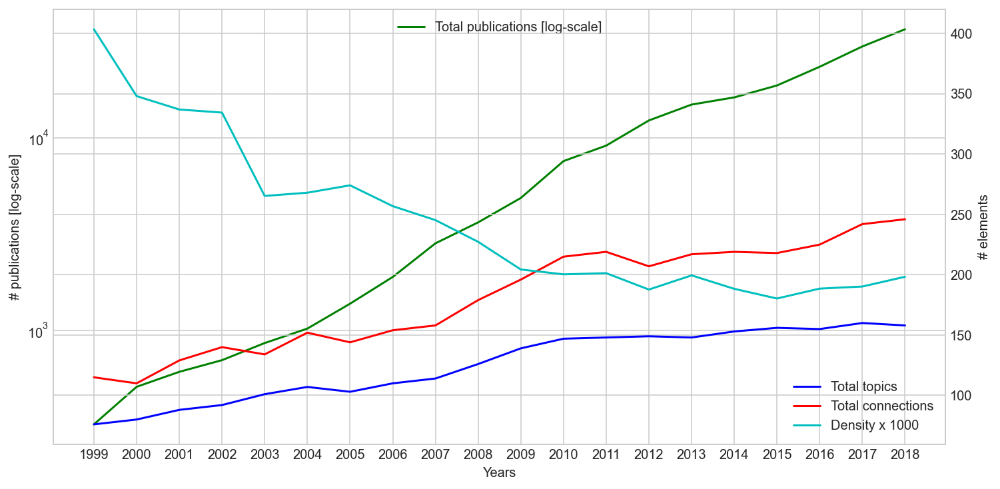

In [12]:
fig = plt.figure(figsize=(12,6))

ax = plt.axes(yscale='log')
ax.plot(d, df_size, color='g', label='Total publications [log-scale]')
ax.xaxis.set_major_locator(plt.MaxNLocator(9))
ax.set_xlabel('Years')
ax.set_ylabel('# publications [log-scale]')
plt.legend(loc='upper center')

ax2 = ax.twinx()
ax2.plot(d, nodes_count, color='b', label='Total topics')
ax2.plot(d, edges_count, color='r', label='Total connections')
ax2.plot(d, density, color='c', label='Density x 1000')
ax2.set_ylabel('# elements')
plt.legend(loc='lower right')
plt.show()

## Display
We visualize a single graph (1999) weighing the dimension of its nodes in size and color.
We can see that initially, the category 'cs' had few links with other categories. Even many of the very subcategories of 'cs' are not referenced.
The nodes are links correspond to those that have only one category in their description. This type of node, in 1999, represents the majority of them.

In [13]:
# We compute node size
# We categorize the sizes to give them a differentiated color
size = []
for n in G_list[0].nodes():
    size.append(G_list[0].nodes[n]['weight'] * 25)
size2 = pd.Categorical(size)

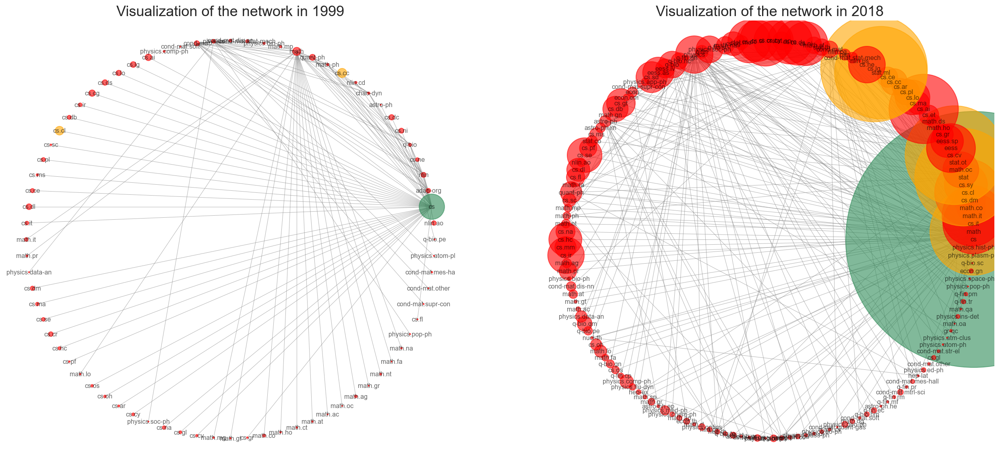

In [14]:
fig = plt.figure(figsize=(22,10))

colors=["red", "orange", "gold", "limegreen", "blue", "green", 
        "yellow", "red", "purple", "seagreen"]
cmap = matplotlib.colors.ListedColormap(colors)
size = []
for n in G_list[0].nodes():
    size.append(G_list[0].nodes[n]['weight'] * 2)
size2 = pd.Categorical(size)
plt.subplot(1, 2, 1)
nx.draw_circular(G_list[0], 
                 with_labels=True,
                 font_size=8, 
                 alpha=0.6,
                 node_color=size2, cmap=cmap,
                 node_size=size,
                 width=.5,
                 edge_color='gray'
                )
plt.title('Visualization of the network in 1999', fontsize=18)


size = []
for n in G_list[19].nodes():
    size.append(G_list[19].nodes[n]['weight'] * 2)
size2 = pd.Categorical(size)
plt.subplot(1, 2, 2)
nx.draw_circular(G_list[19], 
                 with_labels=True, 
                 font_size=8, 
                 alpha=0.6,
                 node_color=size2, cmap=cmap,
                 node_size=size,
                 width=.5,
                 edge_color='gray'
                )
plt.title('Visualization of the network in 2018', fontsize=18)


plt.show()  

### With the same technique, we visualize every year
We can see how the network becomes more complex over the years. New links appear to other topics. The network is densified and the hubs appear sharp very early. No nodes are observed without links (connectivity $ Go_{i} = True $, which shows us that nodes are created as needed.

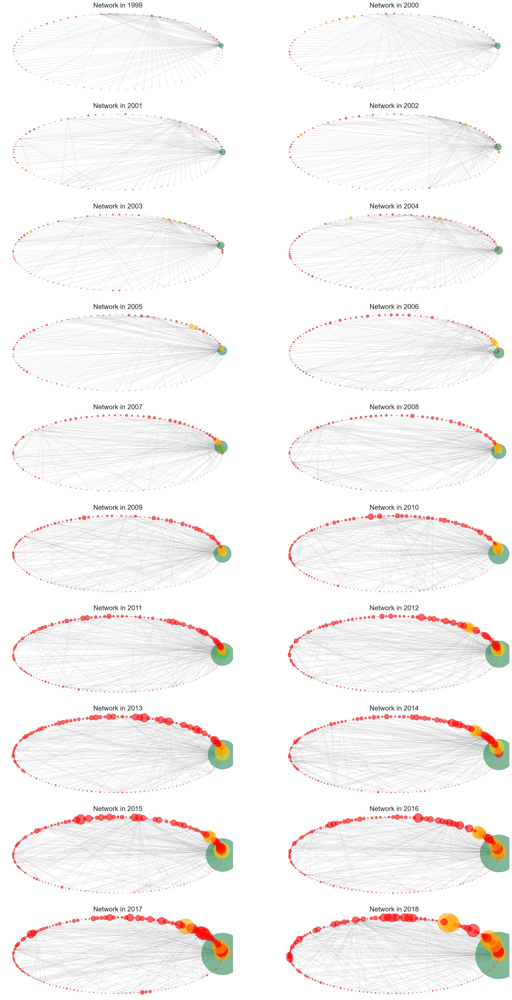

In [15]:
fig = plt.figure(figsize=(24,48))
for i in range (1, 21):
    size = []
    for n in G_list[i-1].nodes():
        size.append(G_list[i-1].nodes[n]['weight'] * 0.3 )
    size_color = pd.Categorical(size)
    plt.subplot(10, 2, i)
    plt.title('Network in {}'.format(d[i-1]), fontsize=18)
    nx.draw_circular(G_list[i-1],
                     with_labels=False,
                     alpha=0.6,
                     node_color=size_color,
                     cmap=cmap,
                     node_size=size,
                     width=.3,
                     edge_color='gray'
                    )                

## Maximum and minimum spanning trees 
We compare both coverage subgraphs for 1999 and 2018

In [16]:
# We compute maximum and minimum spanning trees
max_st1 = tree.maximum_spanning_tree(G_list[0], algorithm="kruskal")
min_st1 = tree.minimum_spanning_tree(G_list[0], algorithm="kruskal")
max_st20 = tree.maximum_spanning_tree(G_list[19], algorithm="kruskal")
min_st20 = tree.minimum_spanning_tree(G_list[19], algorithm="kruskal")

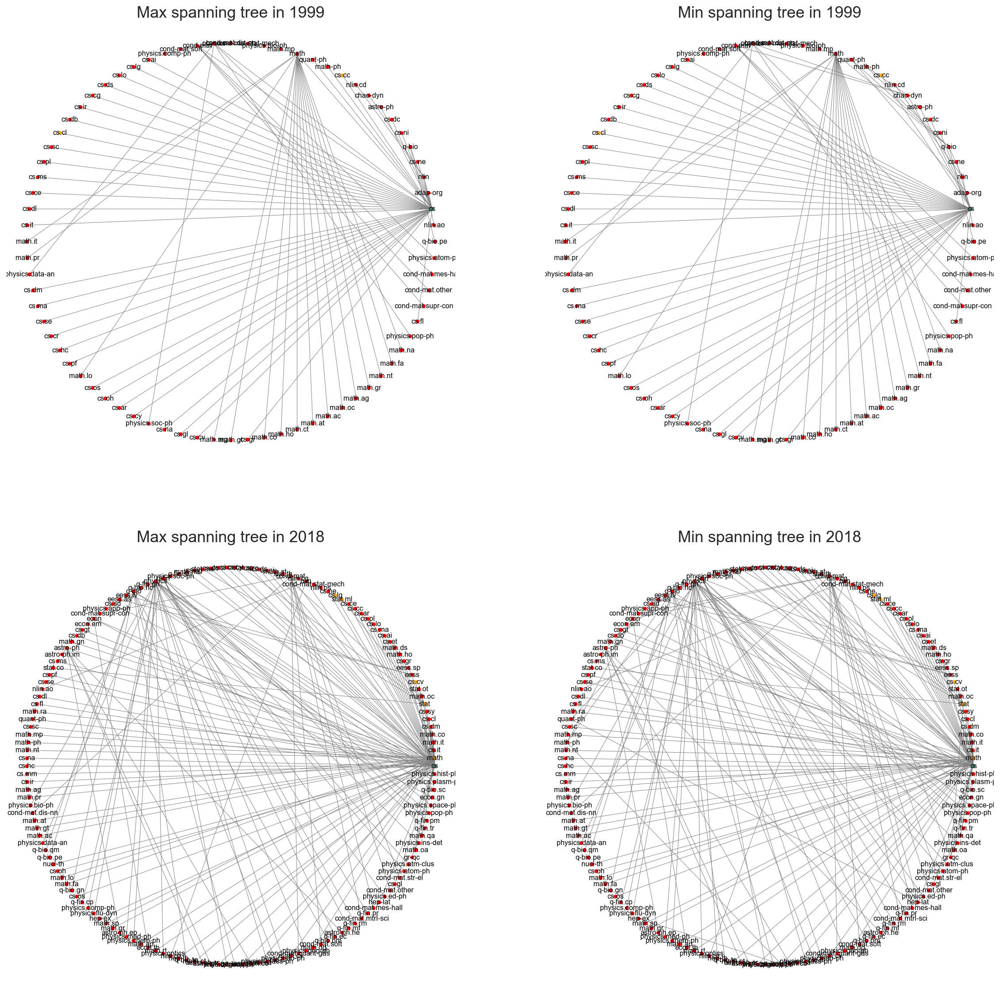

In [17]:
fig = plt.figure(figsize=(20,20))

# G_list[0]
size = []
for n in max_st1.nodes():
    size.append(max_st1.nodes[n]['weight'] * 2)
size2 = pd.Categorical(size)

size = 10
plt.subplot(2, 2, 1)
nx.draw_circular(max_st1,
                 with_labels=True,
                 font_size=8,
                 node_color=size2, cmap=cmap,
                 node_size=size,
                 width=.5,
                 edge_color='gray'
                )
plt.title('Max spanning tree in 1999', fontsize=18)

size = []
for n in min_st1.nodes():
    size.append(min_st1.nodes[n]['weight'] * 2)
size2 = pd.Categorical(size)

size = 10
plt.subplot(2, 2, 2)
nx.draw_circular(min_st1,
                 with_labels=True,
                 font_size=8,
                 node_color=size2, cmap=cmap,
                 node_size=size,
                 width=.5,
                 edge_color='gray',                 
                )
plt.title('Min spanning tree in 1999', fontsize=18)

# G_list[20]
size = []
for n in max_st20.nodes():
    size.append(max_st20.nodes[n]['weight'] * 2)
size2 = pd.Categorical(size)

size = 10
plt.subplot(2, 2, 3)
nx.draw_circular(max_st20,
                 with_labels=True,
                 font_size=8,
                 node_color=size2, cmap=cmap,
                 node_size=size,
                 width=.5,
                 edge_color='gray'
                )
plt.title('Max spanning tree in 2018', fontsize=18)

size = []
for n in min_st20.nodes():
    size.append(min_st20.nodes[n]['weight'] * 2)
size2 = pd.Categorical(size)

size = 10
plt.subplot(2, 2, 4)
nx.draw_circular(min_st20,
                 with_labels=True,
                 font_size=8, 
                 node_color=size2, cmap=cmap,
                 node_size=size,
                 width=.5,
                 edge_color='gray',                 
                )
plt.title('Min spanning tree in 2018', fontsize=18)

plt.show()


## Degree distribution in 2018

A common characteristic of random networks and small world models is that the distribution of degrees is homogeneous, with a concentration around the average value and with an exponential decay. However, in our case we see a clear evolution towards a Scale Free type of network; Except for the first three years, when the network was still small, its behavior tends towards a degree distribution following a Power Law.

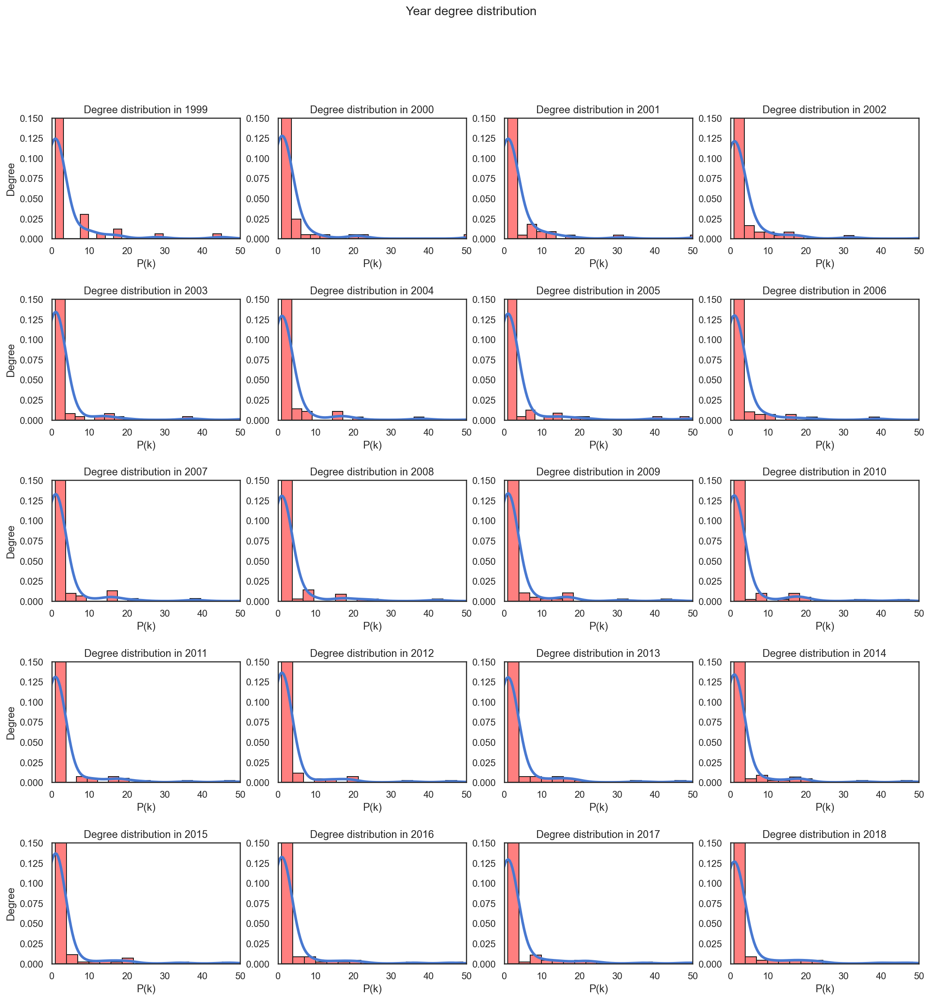

In [136]:
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(18,18) )
i = 0
for r in range(5):
    # Degree sequence ds
    for c in range(4):
        ds = [degree for node, degree in G_list[i].degree()]  
        sns.histplot(ds, kde=False, bins=20, stat='density', ax=axes[r, c], 
                     color = 'red', alpha=0.5, edgecolor='k')
        sns.kdeplot(ds, color='b', linewidth=3, ax=axes[r, c])
        axes[r,c].set_title(f"Degree distribution in {d[i]}")
        axes[r,c].set_ylim(0, 0.15)
        axes[r,c].set_xlim(0, 50)                
        i += 1
plt.setp(axes[:, :], xlabel='P(k)')
plt.setp(axes[:, 0], ylabel='Degree')
plt.setp(axes[:, 1:], ylabel='')

plt.subplots_adjust(hspace=0.5, wspace=0.2)  
plt.suptitle("Year degree distribution")
plt.show()

## Evolution of the center and the periphery
The center is the set of nodes with eccentricity equal to the radius of the graph.
The periphery is the set of nodes with eccentricity equal to the diameter of the graph.

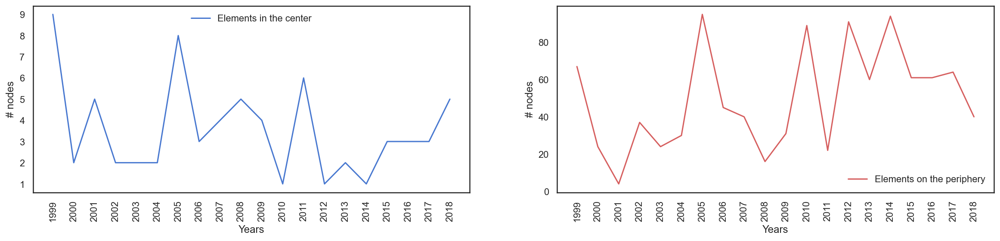

In [139]:
center = []
periphery = []
for i in range(20):
    center.append(len(nx.center(G_list[i])))
    periphery.append(len(nx.periphery(G_list[i])))
    
fig = plt.figure(figsize=(20,4))

plt.subplot(1, 2, 1)
plt.plot(d, center, color='b', label='Elements in the center')
plt.xlabel('Years')
plt.ylabel('# nodes')
plt.legend(loc='upper center')
plt.xticks(rotation=90)

plt.subplot(1, 2, 2)
plt.plot(d, periphery, color='r', label='Elements on the periphery')
plt.xlabel('Years')
plt.ylabel('# nodes')
plt.legend(loc='lower right')
plt.xticks(rotation=90)
plt.show()

## Diameter and radius
Both metrics are uniform. </br>
The diameter represents the largest eccentricity found in the graph. The eccentricity of a node $v$ is the maximum distance from $v$ to all other nodes of $G$. </br>
The radius of $G$ is given by the smallest eccentricity in the graph.

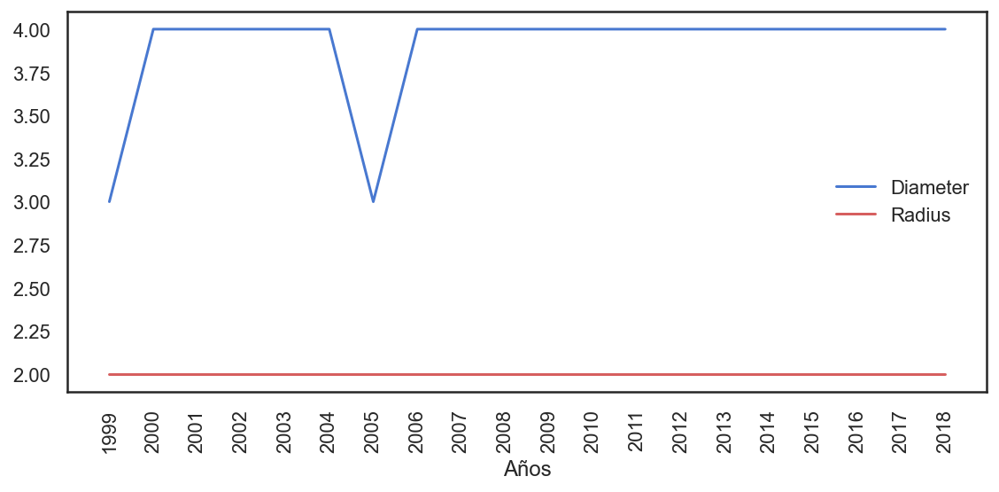

In [140]:
diameter = []
radius = []
for g in G_list:
    diameter.append(nx.diameter(g))
    radius.append(nx.radius(g))
    
fig = plt.figure(figsize=(8,4))

plt.plot(d, diameter, color='b', label='Diameter')
plt.plot(d, radius, color='r', label='Radius')
plt.xlabel('Años')
plt.legend()
plt.xticks(rotation=90)
fig.tight_layout()
plt.show()

## Average density and grouping per year

The "average clustering" is the average of the clustering of all nodes. Clustering, for a weighted graph, is defined in several ways. The one used here is defined as the geometric average of the subgraph edge weights. The weights are normalized with respect to the greatest weight in the network.

The maximum density observed (0.1 in 2000), shows us that the real networks are "sparce".

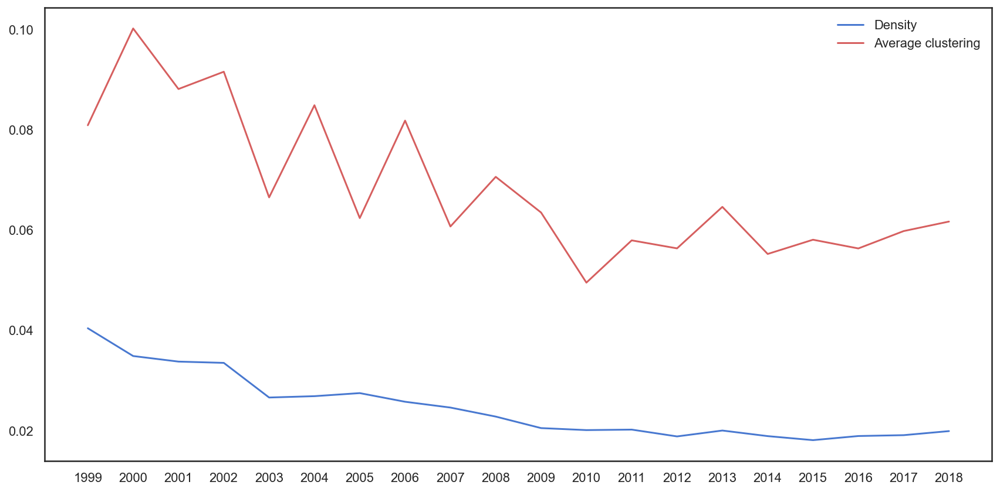

In [141]:
density = []
av_cl = []
for g in G_list:
    density.append(nx.density(g))
    av_cl.append(nx.average_clustering(g))
    
fig = plt.figure(figsize=(12,6))

plt.plot(d, density, color='b', label='Density')
plt.plot(d, av_cl, color='r', label='Average clustering')
plt.legend()
fig.tight_layout()
plt.show()

## Compared maximum branching between 1999 - 2018

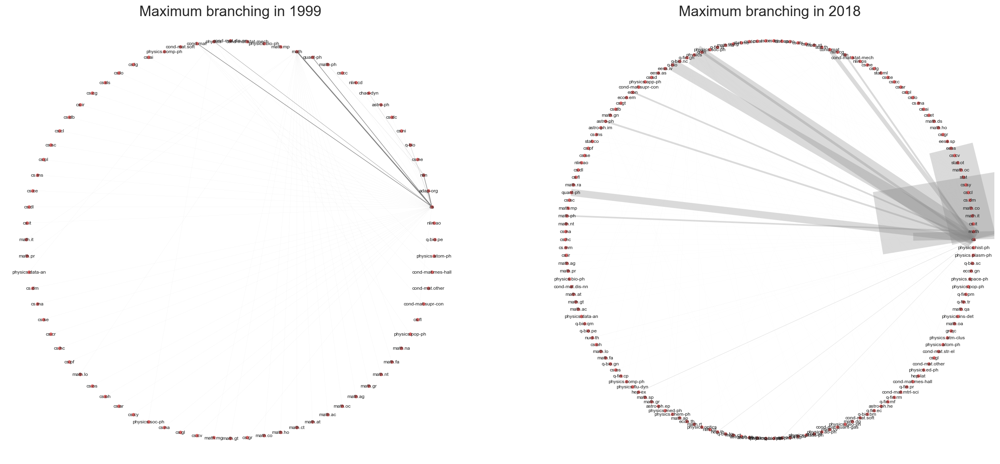

In [142]:
mb1999 = nx.maximum_branching(G_list[0])
mb2018 = nx.maximum_branching(G_list[19])

fig = plt.figure(figsize=(22,10))


# G_list[0]
size = []
for n in mb1999.edges():
    size.append(mb1999.edges[n]['weight'] * 0.02)
edge_size = pd.Categorical(size)

size = 10
plt.subplot(1, 2, 1)
nx.draw_circular(mb1999,
                 with_labels=True,
                 font_size=6, 
                 node_color='r', 
                 node_size=size,
                 width=edge_size,
                 edge_color='gray'
                )
plt.title('Maximum branching in 1999', fontsize=18)

size = []
for n in mb2018.edges():
    size.append(mb2018.edges[n]['weight'] * 0.02)
edge_size = pd.Categorical(size)


size = 10
plt.subplot(1, 2, 2)
nx.draw_circular(mb2018,
                 with_labels=True,
                 font_size=6,
                 node_color='r', 
                 node_size=size,
                 width=edge_size,
                 edge_color=(134/255, 134/255, 134/255, 0.3),                 
                )
plt.title('Maximum branching in 2018', fontsize=18)
plt.show()

##  Adjacency matrices visualization

The visualization of the adjacency matrices give us excellent information on the sparce condition of the networks.

In [146]:
def draw_adjacency_matrix(G, node_order=None, partitions=[], colors=[]):
    """
    Draw the adjacency matrix of the graph G
     - G is a Networkx graph
     - node_order (optional) is a list of nodes, where each node in G
            appears exactly once
     - partitions is a list of node lists, where each node appears in G
            in exactly one list of nodes
     - colors is a list of strings that indicates the color of each one
            partition should be
     If partitions are specified, the same number of colors must be used
     specified.
    """
    adjacency_matrix = nx.to_numpy_matrix(G, dtype=bool, nodelist=node_order)

    # adjacency matrix plotting
    #fig = plt.figure(figsize=(5, 5)) # If we want to use the function in a single plot
    plt.imshow(adjacency_matrix,
               cmap="Reds",
               interpolation="none")
    
    # The rest of the code is only if you have sorted the nodes by a partition and
    # you want to highlight the limits of the module
    assert len(partitions) == len(colors)
    ax = plt.gca()
    for partition, color in zip(partitions, colors):
        current_idx = 0
        for module in partition:
            ax.add_patch(patches.Rectangle((current_idx, current_idx),
                                          len(module), # Width
                                          len(module), # Height
                                          facecolor="none",
                                          edgecolor=color,
                                          linewidth="1"))
            current_idx += len(module)

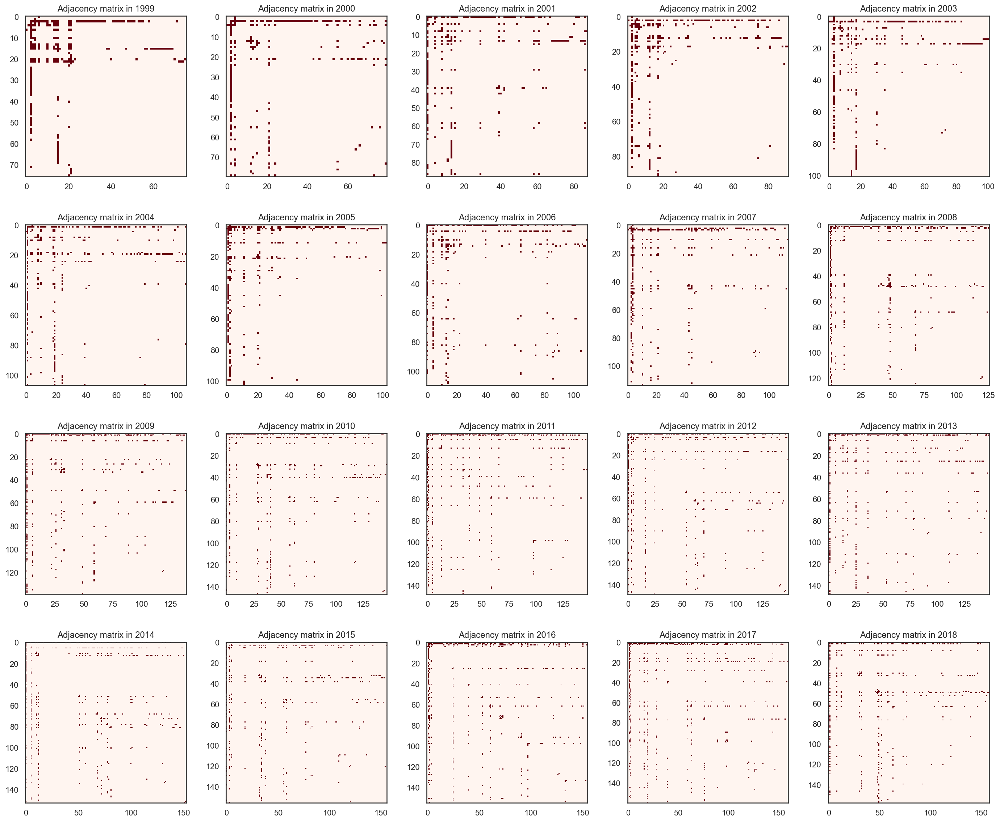

In [147]:
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(24,20) )
i = 0
for g in G_list:
    plt.subplot(4, 5, i+1)
    draw_adjacency_matrix(g)
    plt.title(f"Adjacency matrix in {d[i]}")
    plt.subplots_adjust(hspace=0.3)           
    i += 1
plt.show()

## Community detection (EXPERIMENTAL)

We carry out the redection of communities. </br>
We use Louvain's method described in "Fast unfolding of communities in large networks", DBlondel et.al., Journal of Statistical Mechanics: Theory and Experiment 2008.
The method is sensitive to the ordering of the nodes (and therefore their display in the adjacency matrix). It works on a partition basis, i.e. each node belongs to a single community (which may not be very realistic). The fact that specific communities are seen in the main diagonal (on), that communities are not seen in the other diagonal (off) does not imply that we have done an exhaustive job of detecting communities. A different ordering of the data could probably give better results.

The python-louvain v0.15 library is used
```
pip install python-louvain
```


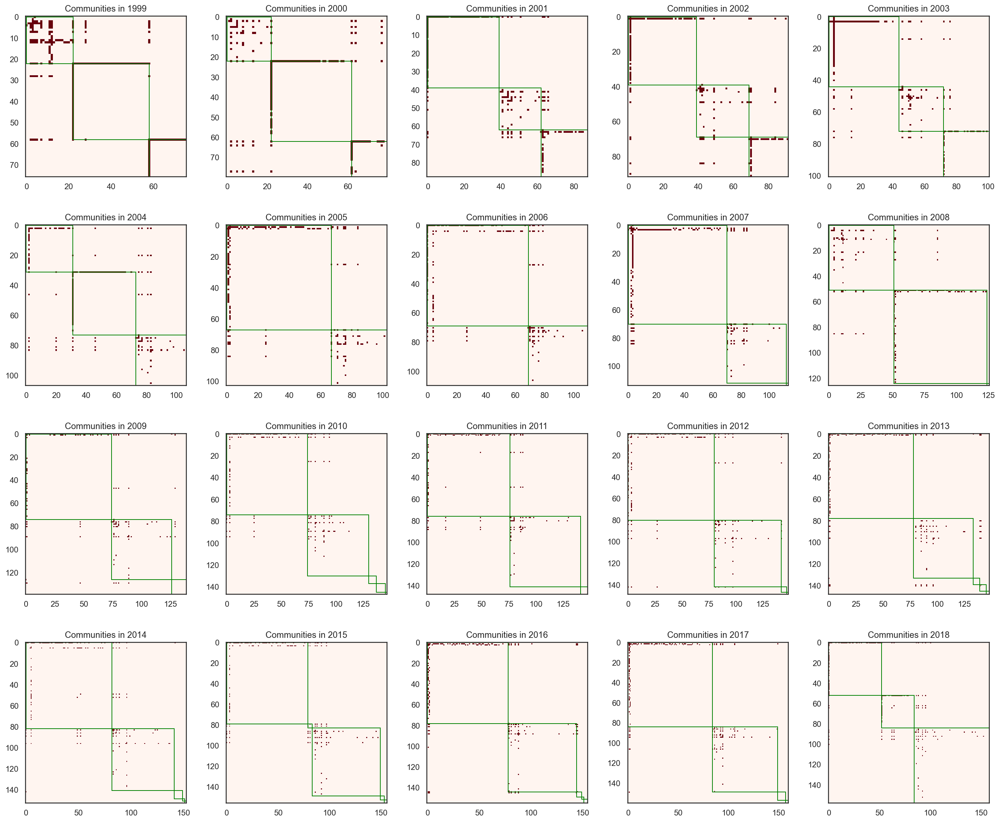

In [148]:
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(24,20) )
i = 0
for g in G_list:    
    # Community discovery algorithm
    louvain_community_dict = louvain.best_partition(g)

    # convert the dict of assignments to communities into a list
    louvain_comms = defaultdict(list)
    for node_index, comm_id in louvain_community_dict.items():
        louvain_comms[comm_id].append(node_index)
    louvain_comms = louvain_comms.values()

    nodes_louvain_ordered = [node for comm in louvain_comms for node in comm]
    plt.subplot(4, 5, i+1)
    # draw_adjacency_matrix(g)
    draw_adjacency_matrix(G_list[0], nodes_louvain_ordered, [louvain_comms], ["green"])
    plt.title(f"Communities in {d[i]}")
    plt.subplots_adjust(hspace=0.3)           
    i += 1
plt.show()

We can do the same by visualizing the graph itself.

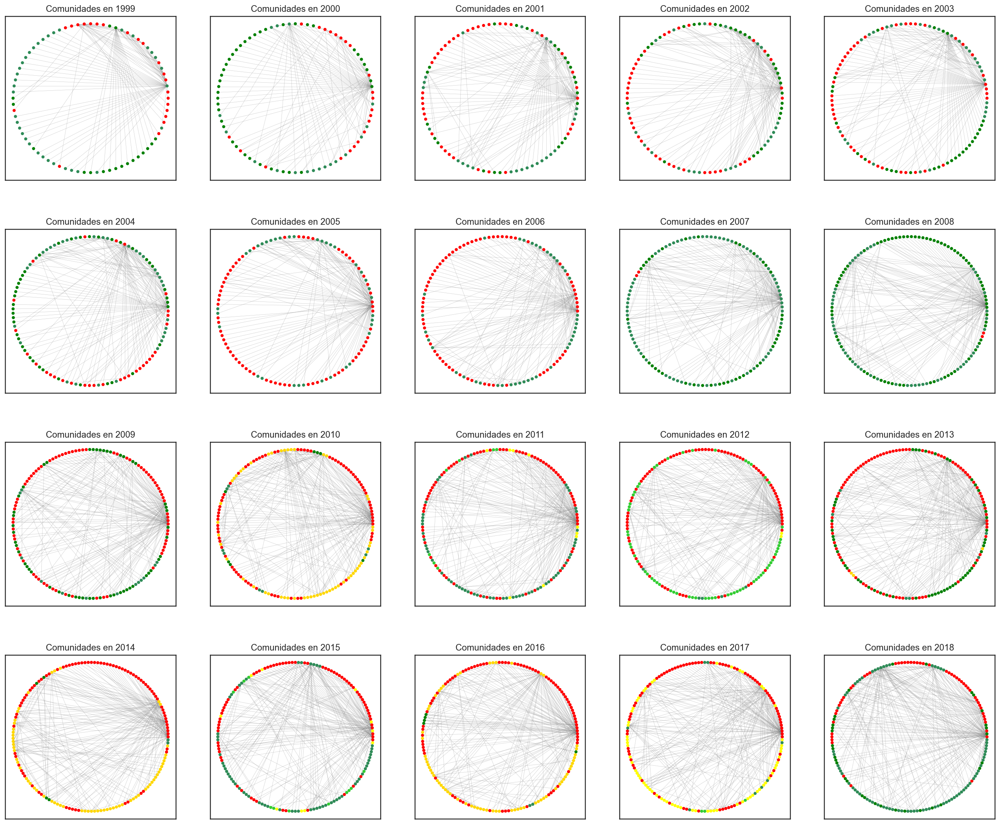

In [149]:
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(24,20) )
i = 0
for g in G_list:   
    
    # compute the best partition
    partition = louvain.best_partition(g)
    cmap = matplotlib.colors.ListedColormap(colors)


    # plotting
    pos = nx.circular_layout(g)
    plt.subplot(4, 5, i+1)
    plt.title("Comunidades en {}".format(d[i]))
    plt.subplots_adjust(hspace=0.3)           
    nx.draw_networkx_nodes(g, pos, 
                           partition.keys(), 
                           node_size=10,
                           cmap=cmap, 
                           node_color=list(partition.values()))
    nx.draw_networkx_edges(g, pos, 
                           alpha=0.5,
                           width=.3,
                           edge_color='gray')
    i += 1
plt.show()

## k-cores
We remove the self-loops. At this point. we lost the original graph.
To maintain it, a copy would have to be made, the remove_edges method acts on the dictionary of the graph directly, it does not return a new pruned graph.

In [150]:
for g in G_list:
    g.remove_edges_from(nx.selfloop_edges(g))

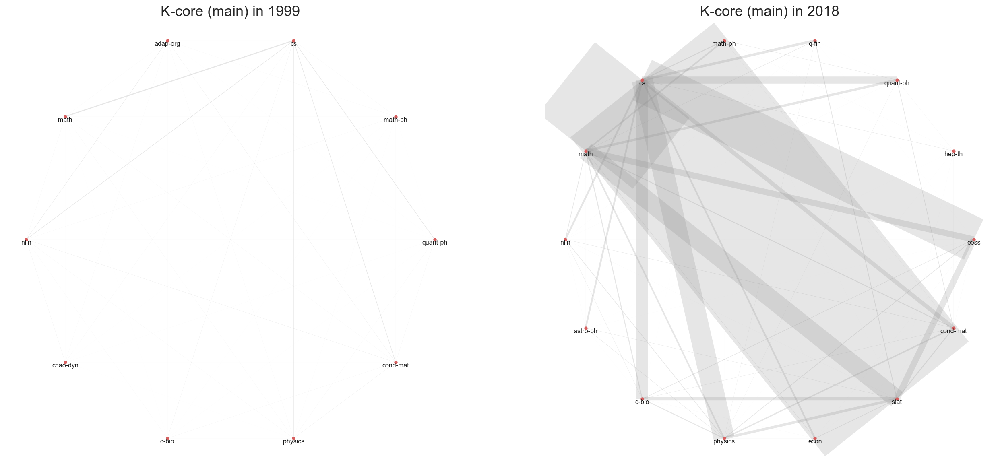

In [151]:
kc1999 = nx.k_core(G_list[0])
kc2018 = nx.k_core(G_list[19])

fig = plt.figure(figsize=(22,10))


# G_list[0]
size = []
for n in kc1999.edges():
    size.append(kc1999.edges[n]['weight'] * 0.02)
edge_size = pd.Categorical(size)

node_size = 10
plt.subplot(1, 2, 1)
nx.draw_circular(kc1999,
                 with_labels=True,
                 font_size=8,
                 node_color='r', 
                 node_size=node_size,
                 width=edge_size,
                 verticalalignment='top',
                 edge_color=(134/255, 134/255, 134/255, 0.2)
                )
plt.title('K-core (main) in 1999', fontsize=18)

size = []
for n in kc2018.edges():
    size.append(kc2018.edges[n]['weight'] * 0.02)
edge_size = pd.Categorical(size)



plt.subplot(1, 2, 2)
nx.draw_circular(kc2018,
                 with_labels=True,
                 font_size=8,
                 node_color='r', 
                 node_size=node_size,
                 width=edge_size,
                 verticalalignment='top',
                 edge_color=(134/255, 134/255, 134/255, 0.2),                 
                )
plt.title('K-core (main) in 2018', fontsize=18)
plt.show()

## K-shell max computing

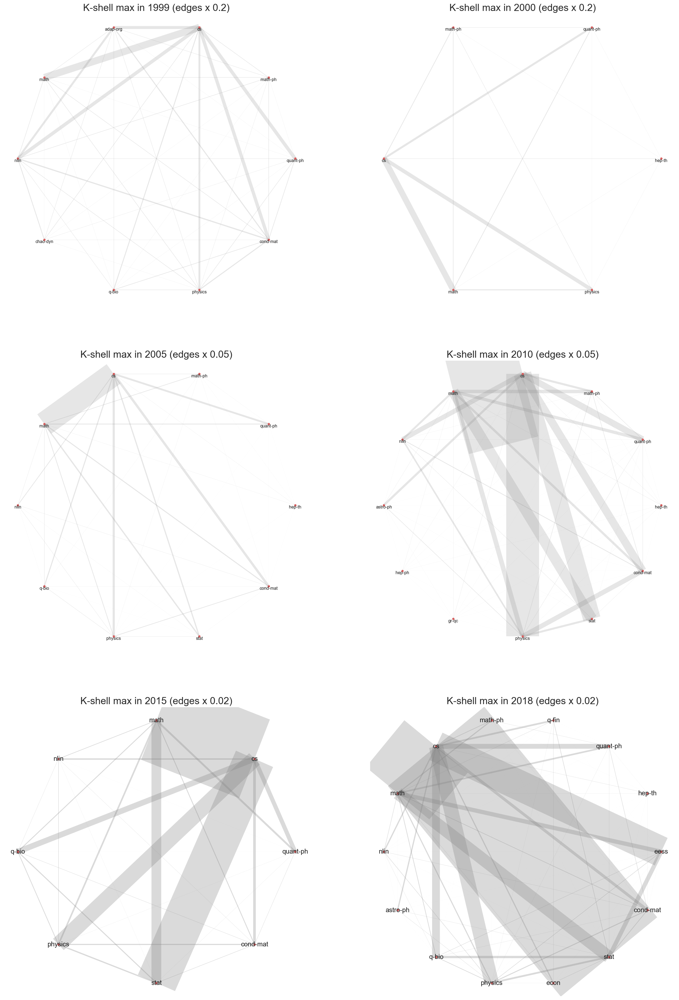

In [154]:
ks1999_max = nx.k_shell(G_list[0])
ks2000_max = nx.k_shell(G_list[1])
ks2005_max = nx.k_shell(G_list[7])
ks2010_max = nx.k_shell(G_list[12])
ks2015_max = nx.k_shell(G_list[17])
ks2018_max = nx.k_shell(G_list[19])

fig = plt.figure(figsize=(22,33))


# G_list[0] - 1999 ********************
size = []
for n in ks1999_max.edges():
    size.append(ks1999_max.edges[n]['weight'] * 0.2)
edge_size = pd.Categorical(size)

node_size = 10
plt.subplot(3, 2, 1)
nx.draw_circular(ks1999_max,
                 with_labels=True,
                 font_size=8,
                 verticalalignment='top',
                 node_color='r', 
                 node_size=node_size,
                 width=edge_size,
                 edge_color=(134/255, 134/255, 134/255, 0.2)
                )
plt.title('K-shell max in 1999 (edges x 0.2)', fontsize=18)

size = []
for n in ks2000_max.edges():
    size.append(ks2000_max.edges[n]['weight'] * 0.2)
edge_size = pd.Categorical(size)



plt.subplot(3, 2, 2)
nx.draw_circular(ks2000_max,
                 with_labels=True,
                 font_size=8,
                 verticalalignment='top',
                 node_color='r', 
                 node_size=node_size,
                 width=edge_size,
                 edge_color=(134/255, 134/255, 134/255, 0.2),                 
                )
plt.title('K-shell max in 2000 (edges x 0.2)', fontsize=18)


# G_list[19] - 2018 *******************
size = []
for n in ks2005_max.edges():
    size.append(ks2005_max.edges[n]['weight'] * 0.05)
edge_size = pd.Categorical(size)


plt.subplot(3, 2, 3)
nx.draw_circular(ks2005_max,
                 with_labels=True,
                 font_size=8,
                 verticalalignment='top',
                 node_color='r', 
                 node_size=node_size,
                 width=edge_size,
                 edge_color=(134/255, 134/255, 134/255, 0.2)
                )
plt.title('K-shell max in 2005 (edges x 0.05)', fontsize=18)

size = []
for n in ks2010_max.edges():
    size.append(ks2010_max.edges[n]['weight'] * 0.05)
edge_size = pd.Categorical(size)



plt.subplot(3, 2, 4)
nx.draw_circular(ks2010_max,
                 with_labels=True,
                 font_size=8,
                 verticalalignment='top',
                 node_color='r', 
                 node_size=node_size,
                 width=edge_size,
                 edge_color=(134/255, 134/255, 134/255, 0.2),                 
                )
plt.title('K-shell max in 2010 (edges x 0.05)', fontsize=18)

size = []
for n in ks2015_max.edges():
    size.append(ks2015_max.edges[n]['weight'] * 0.02)
edge_size = pd.Categorical(size)


plt.subplot(3, 2, 5)
nx.draw_circular(ks2015_max,
                 with_labels=True,
                 node_color='r', 
                 node_size=node_size,
                 width=edge_size,
                 edge_color=(134/255, 134/255, 134/255, 0.3)
                )
plt.title('K-shell max in 2015 (edges x 0.02)', fontsize=18)

size = []
for n in ks2018_max.edges():
    size.append(ks2018_max.edges[n]['weight'] * 0.02)
edge_size = pd.Categorical(size)



plt.subplot(3, 2, 6)
nx.draw_circular(ks2018_max,
                 with_labels=True,
                 node_color='r', 
                 node_size=node_size,
                 width=edge_size,
                 edge_color=(134/255, 134/255, 134/255, 0.3),                 
                )
plt.title('K-shell max in 2018 (edges x 0.02)', fontsize=18)


plt.show()

## Persistence
Saving the graph in a gml structure for visualization in Cytoscape

In [ ]:
nx.write_gml(G_list[0], 'G1999.gml')
nx.write_gml(G_list[19], 'G2018.gml')

## Visualization in Cytoscape

Finally we develop visualizations in Cytoscape.

### Year 1999

<img src="G1999.gml_2.png" width="2200" >

### Year 2018

<img src="G2018.gml_1.png" width="2200" >

Year 2018 with a visualization of the weighted edges

<img src="G2018.gml_2.png" width="2200">

:)